<a href="https://colab.research.google.com/github/sourcecode369/deep-nlp/blob/master/image%20captioning/Image_Captioning_with_Visual_Attention.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from __future__ import absolute_import, print_function, division, unicode_literals
from builtins import range, input

In [2]:
%tensorflow_version 2.x
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.model_selection import train_test_split 
from sklearn.utils import shuffle

import re
import json
import os
import time
from glob import glob 
from PIL import Image
import pickle

import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")

TensorFlow 2.x selected.


In [3]:
annontation_folder = '/annotations/'
if not os.path.exists(os.path.abspath('.')+annontation_folder):
  annotation_zip = tf.keras.utils.get_file('captions.zip',
                                           cache_subdir=os.path.abspath('.'),
                                           origin = 'http://images.cocodataset.org/annotations/annotations_trainval2014.zip',
                                           extract = True
                                          )
  annotation_file = os.path.dirname(annotation_zip) + '/annotations/captions_train2014.json'
  os.remove(annotation_zip)

image_folder = '/train2014/'
if not os.path.exists(os.path.abspath('.') + image_folder):
  image_zip = tf.keras.utils.get_file('train2014.zip',
                                      cache_subdir=os.path.abspath('.'),
                                      origin='http://images.cocodataset.org/zips/train2014.zip',
                                      extract=True)
  PATH = os.path.dirname(image_zip) + image_folder
  os.remove(image_zip)
else:
  PATH = os.path.abspath('.') + image_folder 

13510574080/13510573713 [==============================] - 371s 0us/step


In [0]:
with open(annotation_file, 'r') as f:
  annotations = json.load(f)

In [0]:
all_captions = []
all_image_name_vector = []
for annot in annotations['annotations']:
  caption = '<start>' + annot['caption'] + '<end>'
  image_id = annot['image_id']
  full_coco_image_path = PATH + 'COCO_train2014_' + '%012d.jpg' % (image_id)
  all_image_name_vector.append(full_coco_image_path)
  all_captions.append(caption)

In [0]:
train_captions, img_name_vector = shuffle(all_captions, all_image_name_vector, random_state=1)

In [0]:
num_examples = 30000
train_captions = train_captions[:num_examples]
img_name_vector = img_name_vector[:num_examples]

In [0]:
def load_image(image_path):
  img = tf.io.read_file(image_path)
  img = tf.image.decode_jpeg(img,channels=3)
  img = tf.image.resize(img, (299,299))
  img = tf.keras.applications.inception_v3.preprocess_input(img)
  return img, image_path

In [13]:
image_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')
new_input = image_model.input 
hidden_layer = image_model.layers[-1].output
image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

87916544/87910968 [==============================] - 3s 0us/step


In [22]:
from tqdm import tqdm, tqdm_notebook
encode_train = sorted(set(img_name_vector))
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
    load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16).prefetch(tf.data.experimental.AUTOTUNE)
for img, path in tqdm(image_dataset):
  batch_features = image_features_extract_model(img)
  batch_features = tf.reshape(batch_features, (batch_features.shape[0], -1, batch_features.shape[3]))
  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode('utf-8')
    np.save(path_of_feature, bf.numpy())

1622it [06:03,  4.61it/s]


In [0]:
def calc_max_length(tensor):
  return max(len(t) for t in tensor)

In [0]:
top_k = 5000
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k, 
                                                  oov_token="<unk>", 
                                                  filters='!"#$%^&*()?/.,:;][{}\|`~+_=-]')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [0]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [0]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [0]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')
max_length = calc_max_length(train_seqs)

In [74]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector, 
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(24000, 24000, 6000, 6000)

In [0]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 512
units = 1024
vocab_size = top_k + 1
num_steps = len(img_name_train) // BATCH_SIZE

feature_shape = 2048
attention_features_shape = 64

In [0]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8') + '.npy')
  return img_tensor, cap

In [0]:
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [0]:
class BahdanauAttention(tf.keras.Model):
  def __init__(self, units):
    super(BahdanauAttention, self).__init__()
    self.W1 = tf.keras.layers.Dense(units)
    self.W2 = tf.keras.layers.Dense(units)
    self.V = tf.keras.layers.Dense(1)

  def call(self, features, hidden):
    hidden_with_time_axis = tf.expand_dims(hidden, 1)
    score = tf.nn.tanh(self.W1(features) + self.W2(hidden_with_time_axis))
    attention_weights = tf.nn.softmax(self.V(score), axis=1)
    context_vector = attention_weights * features
    context_vector = tf.reduce_sum(context_vector, axis=1)
    return context_vector, attention_weights

In [0]:
class CNN_Encoder(tf.keras.Model):
    def __init__(self, embedding_dim):
        super(CNN_Encoder, self).__init__()
        self.fc = tf.keras.layers.Dense(embedding_dim)
    
    def call(self, x):
        x = self.fc(x)
        x = tf.nn.relu(x)
        return x

In [0]:
class RNN_Decoder(tf.keras.Model):
  def __init__(self, embedding_dim, units, vocab_size):
    super(RNN_Decoder, self).__init__()
    self.units = units
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.gru = tf.keras.layers.GRU(self.units,
                                   return_sequences=True,
                                   return_state=True,
                                   recurrent_initializer='glorot_uniform')
    self.fc1 = tf.keras.layers.Dense(self.units)
    self.fc2 = tf.keras.layers.Dense(vocab_size)
    self.attention = BahdanauAttention(self.units)
  
  def call(self, x, features, hidden):
    context_vector, attention_weights = self.attention(features, hidden)
    x = self.embedding(x)
    x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)
    output, state = self.gru(x)
    x = self.fc1(output)
    x = tf.reshape(x, (-1, x.shape[2]))
    x = self.fc2(x)
    return x, state, attention_weights

  def reset_state(self, batch_size):
    return tf.zeros((batch_size, self.units))

In [0]:
encoder = CNNEncoder(embedding_dim=embedding_dim)
decoder = RNNDecoder(embedding_dim, units, vocab_size)

In [0]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)
  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  return tf.reduce_mean(loss_)

In [0]:
checkpoint_path = "./checkpoints/train"
ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer = optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

In [0]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
  start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])
  ckpt.restore(ckpt_manager.latest_checkpoint)

In [0]:
loss_plot = []

In [0]:
@tf.function
def train_step(img_tensor, target):
  loss = 0
  hidden = decoder.reset_state(batch_size=target.shape[0])
  dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * target.shape[0], 1)
  with tf.GradientTape() as tape:
      features = encoder(img_tensor)
      for i in range(1, target.shape[1]):
          predictions, hidden, _ = decoder(dec_input, features, hidden)
          loss += loss_function(target[:, i], predictions)
          dec_input = tf.expand_dims(target[:, i], 1)
  total_loss = (loss / int(target.shape[1]))
  trainable_variables = encoder.trainable_variables + decoder.trainable_variables
  gradients = tape.gradient(loss, trainable_variables)
  optimizer.apply_gradients(zip(gradients, trainable_variables))
  return loss, total_loss

In [125]:
EPOCHS = 25

for epoch in range(start_epoch, EPOCHS):
    start = time.time()
    total_loss = 0
    for (batch, (img_tensor, target)) in enumerate(dataset):
        batch_loss, t_loss = train_step(img_tensor, target)
        total_loss += t_loss
        if batch % 100 == 0:
            print ('Epoch {} Batch {} Loss {:.4f}'.format(
              epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))
    loss_plot.append(total_loss / num_steps)
    if epoch % 5 == 0:
      ckpt_manager.save()
    print ('Epoch {} Loss {:.6f}'.format(epoch + 1,
                                         total_loss/num_steps))
    print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 1.8198
Epoch 1 Batch 100 Loss 1.0478
Epoch 1 Batch 200 Loss 0.8326
Epoch 1 Batch 300 Loss 0.8371
Epoch 1 Loss 0.960285
Time taken for 1 epoch 392.91468381881714 sec

Epoch 2 Batch 0 Loss 0.8450
Epoch 2 Batch 100 Loss 0.8208
Epoch 2 Batch 200 Loss 0.7694
Epoch 2 Batch 300 Loss 0.7511
Epoch 2 Loss 0.762633
Time taken for 1 epoch 377.8235378265381 sec

Epoch 3 Batch 0 Loss 0.7990
Epoch 3 Batch 100 Loss 0.6817
Epoch 3 Batch 200 Loss 0.6854
Epoch 3 Batch 300 Loss 0.6707
Epoch 3 Loss 0.699994
Time taken for 1 epoch 378.77169704437256 sec

Epoch 4 Batch 0 Loss 0.6502
Epoch 4 Batch 100 Loss 0.7297
Epoch 4 Batch 200 Loss 0.6621
Epoch 4 Batch 300 Loss 0.6707
Epoch 4 Loss 0.657186
Time taken for 1 epoch 377.8568866252899 sec

Epoch 5 Batch 0 Loss 0.6136
Epoch 5 Batch 100 Loss 0.6250
Epoch 5 Batch 200 Loss 0.5736
Epoch 5 Batch 300 Loss 0.5825
Epoch 5 Loss 0.620898
Time taken for 1 epoch 377.1034777164459 sec

Epoch 6 Batch 0 Loss 0.5593
Epoch 6 Batch 100 Loss 0.6200
Epoch 6 Ba

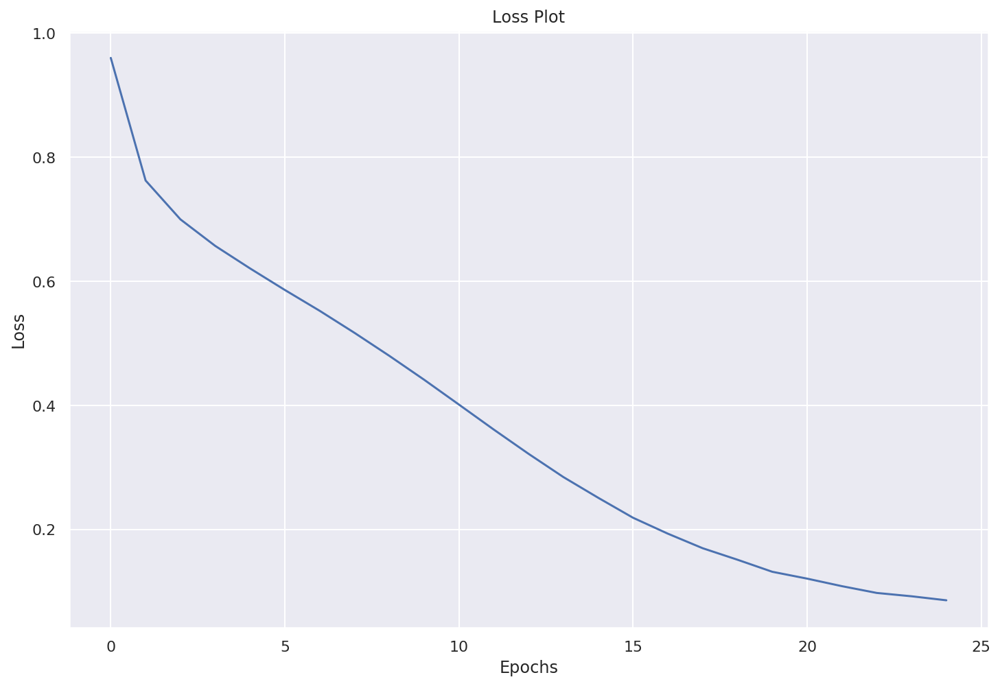

In [126]:
import seaborn as sns
%config InlineBackend.figure_format = 'retina'
sns.set_style("whitegrid")
sns.set(rc={"figure.figsize":(12,8)})

plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

In [0]:
def evaluate(image):
  attention_plot = np.zeros((max_length, attention_features_shape))
  hidden = decoder.reset_state(batch_size=1)
  temp_input = tf.expand_dims(load_image(image)[0],0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  features = encoder(img_tensor_val)
  dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
  result = []
  for i in range(max_length):
    predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
    attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
    predicted_id = tf.random.categorical(predictions, 1)[0][0].numpy()
    result.append(tokenizer.index_word[predicted_id])
    if tokenizer.index_word[predicted_id] == "<end>":
      return result, attention_plot
    dec_input = tf.expand_dims([predicted_id],0)
  attention_plot = attention_plot[:len(result),:]
  return result, attention_plot

In [0]:
def plot_attention(image, result, attention_plot):
  temp_image = np.array(Image.open(image))
  fig = plt.figure(figsize=(16,12))
  len_result = len(result)
  for l in range(len_result):
    temp_att = np.resize(attention_plot[l], (10,10))
    ax = fig.add_subplot(len_result//2, len_result//2, l+1)
    ax.set_title(result[l])
    img = ax.imshow(temp_image)
    ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())
  plt.tight_layout()
  plt.show()

In [140]:
print("30s\ hellow world")
print("30s\ my name is rohit")

30s\ hellow world
30s\ my name is rohit


Real Caption: <start>a pizza with sausage and whole slices of cheese on top <end>

Predicted Caption: <start> vegetable pizza has been leaves on a pizza are sitting on top of white plate with ready to look like a number of toppings on top of a pan onto some vegetables ready to go box <end>


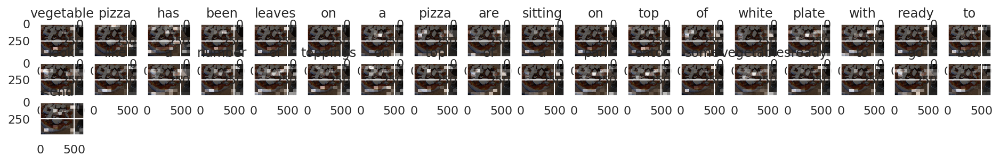


Real Caption: <start>a man and a dog in a horse drawn buggy <end>

Predicted Caption: <start> horse pulling a man in the middle <end>


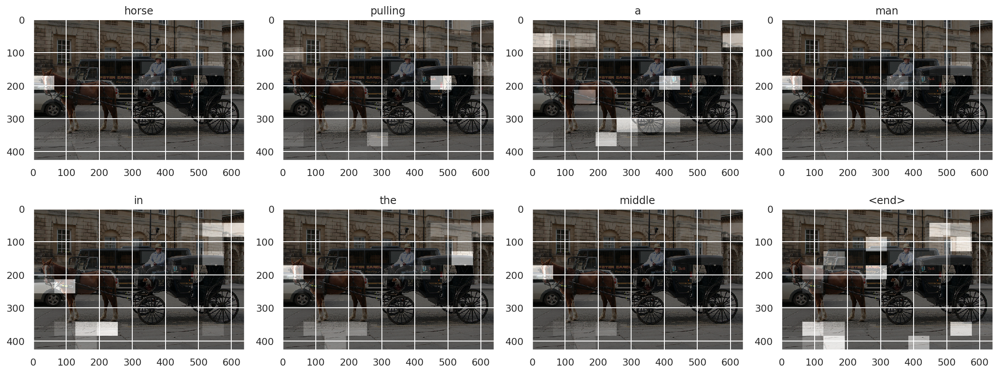


Real Caption: <start>a very large white vase sitting on top of a stand <end>

Predicted Caption: <start> close up of a vase on its neck attached to the vase <end>


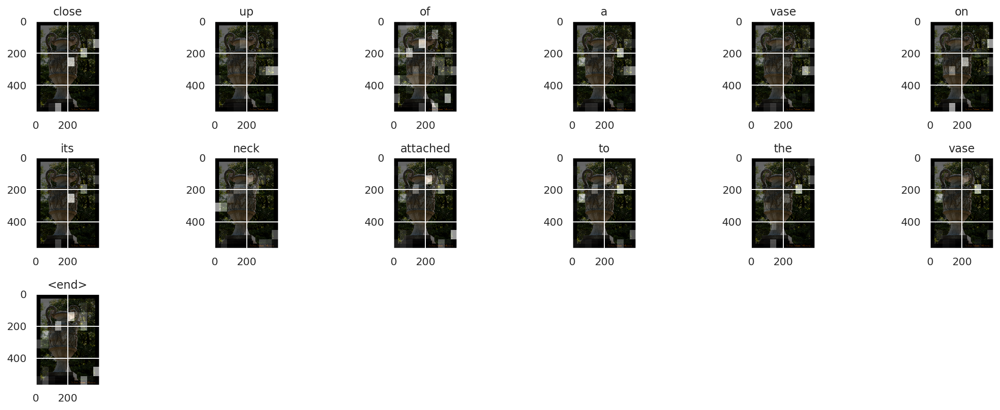


Real Caption: <start>a sandwich and french fries on a white plate<end>

Predicted Caption: <start> white plate with french fries and a salad and wedge fries <end>


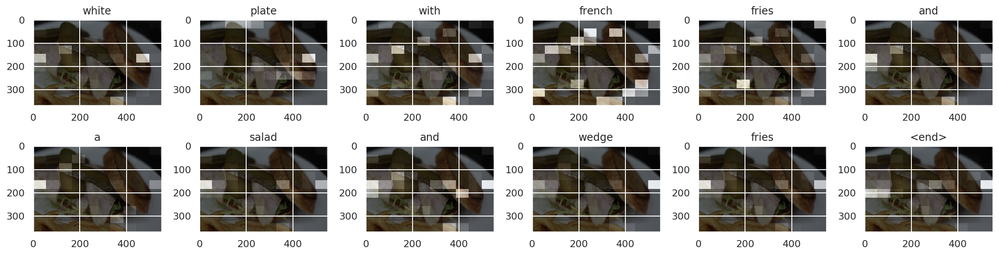


Real Caption: <start>a china <unk> airlines <unk> <unk> <unk> on approach <end>

Predicted Caption: <start> large cathedral on a airport <end>


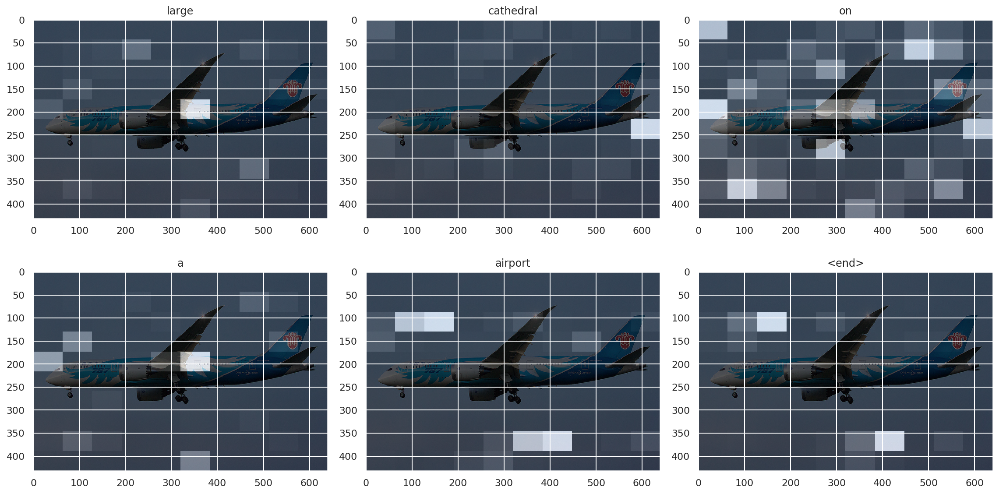


Real Caption: <start>many elephants travel around a river of water<end>

Predicted Caption: <start> herd of elephants walking in the park <end>


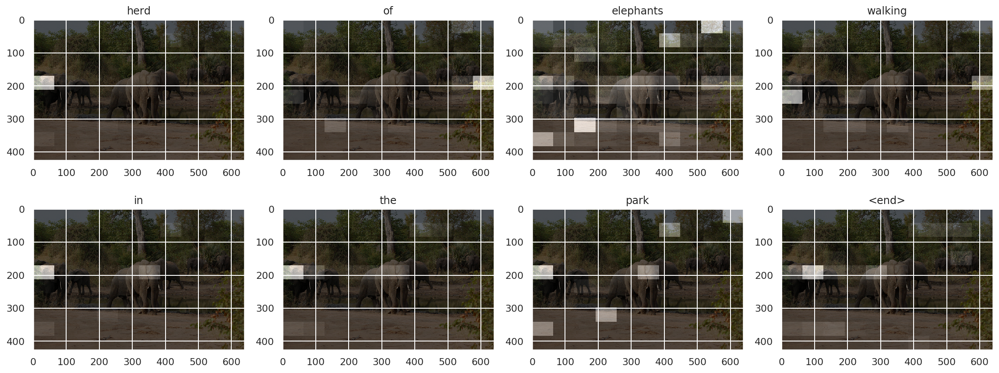


Real Caption: <start>a team of <unk> fighting to put out a fire at a business <end>

Predicted Caption: <start> service truck is standing near a street with a building <end>


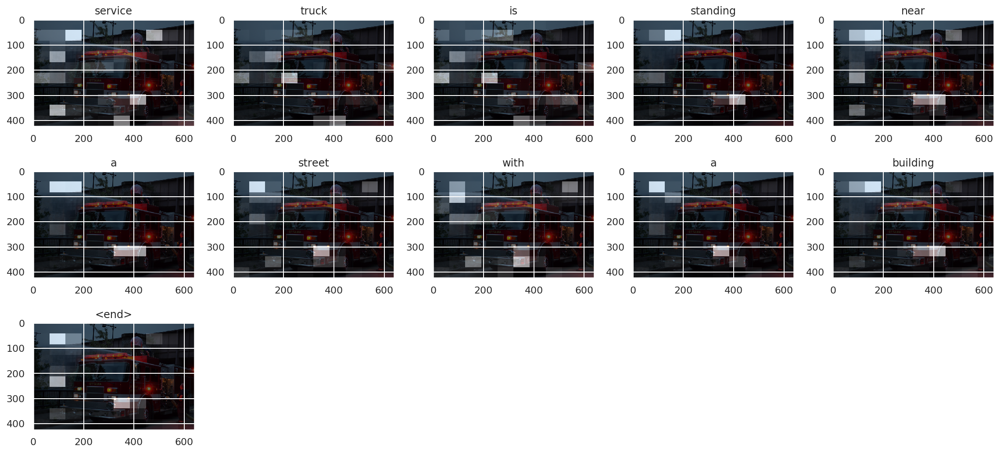


Real Caption: <start>a child sitting in a high chair with mom holding a cake <end>

Predicted Caption: <start> person and girl sitting beside a small child <end>


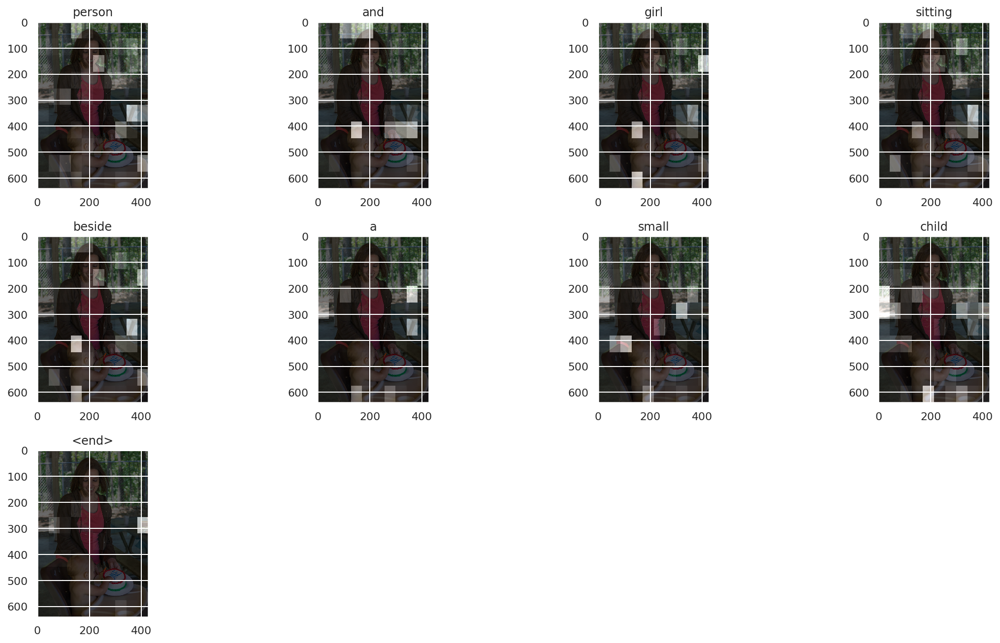


Real Caption: <start>a person skis down a mountain slope <unk> trees in the background <end>

Predicted Caption: <start> person wearing a yellow and white snow boarder is skiing down a hill <end>


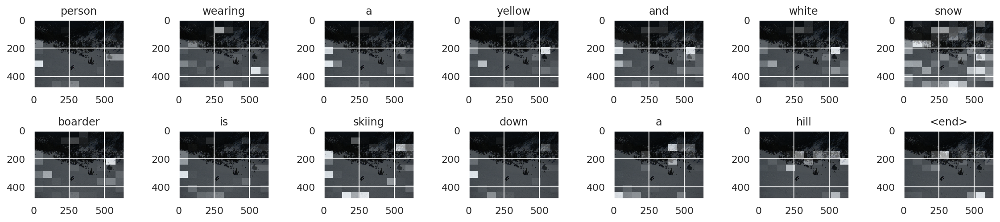


Real Caption: <start>two boats float in the water near a bridge <end>

Predicted Caption: <start> boat in front of a river <end>


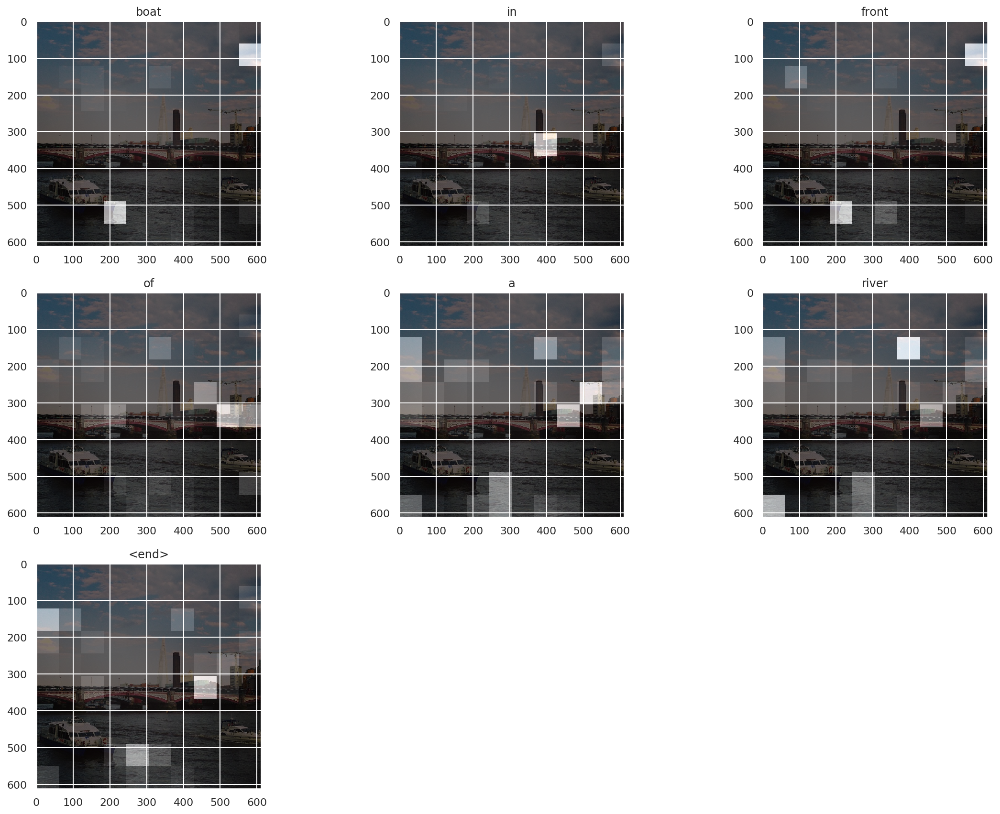


Real Caption: <start>a plate of food and they glass of a drink <end>

Predicted Caption: <start> is an assortment of birthday cake and spoon sits on top of a table with <unk> top <end>


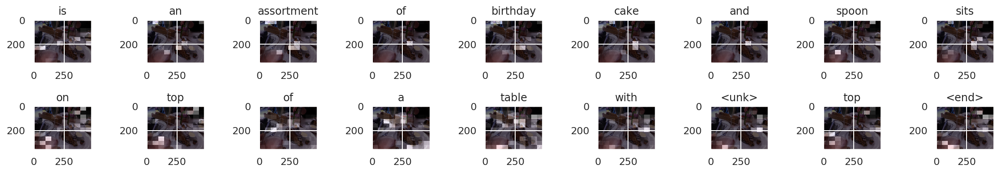


Real Caption: <start>a large building with all sorts of lawn <unk>

Predicted Caption: <start> small wooden boat on top of a white truck <end>


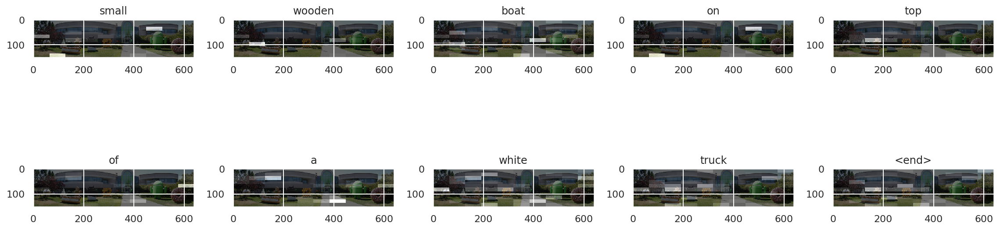


Real Caption: <start>a large pizza with various types of cheese <end>

Predicted Caption: <start> pepperoni pizza has two tomatoes <unk> it's lap top filled plate there is a pepperoni pizza plate<end> <unk> it's lap top filled cake<end> table bar mugs cheese cat on top of polka dot table bar covering it's lap top filled cake<end> table bar covered in front garden table


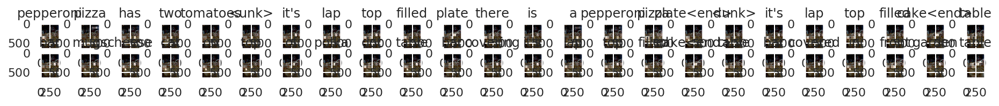


Real Caption: <start>a group of people sitting around a table <end>

Predicted Caption: <start> girl and girl at an a woman with some wine <end>


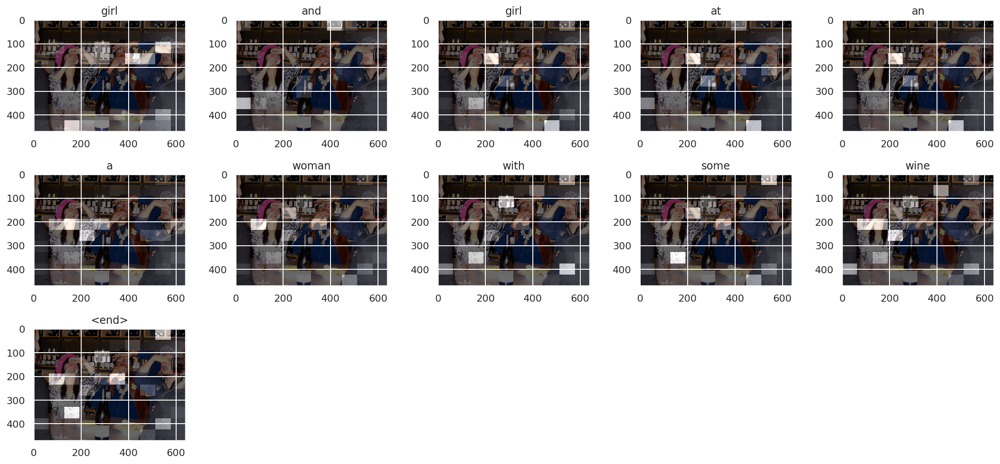


Real Caption: <start>a man walks to the ocean while holding a surf board <end>

Predicted Caption: <start> young man in swim trunks <end>


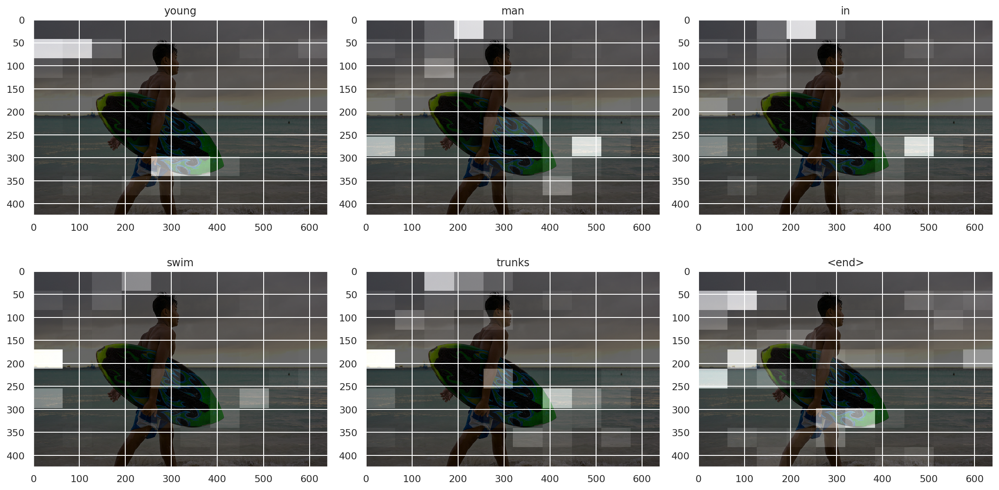


Real Caption: <start>a square cut pizza with an assortment of toppings such as cheese and olives <end>

Predicted Caption: <start> close up of a pizza placed on a dish box <end>


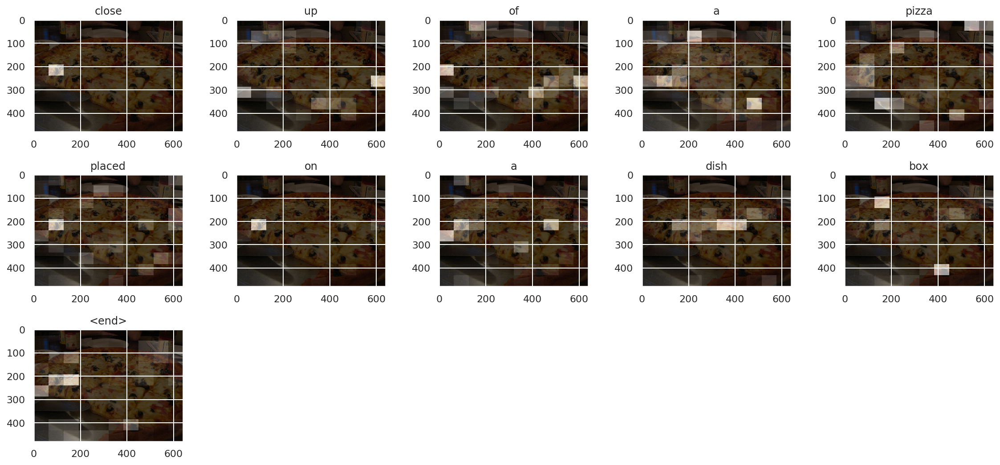


Real Caption: <start>a man on a court with a tennis racket <end>

Predicted Caption: <start> woman playing tennis on a green ball <end>


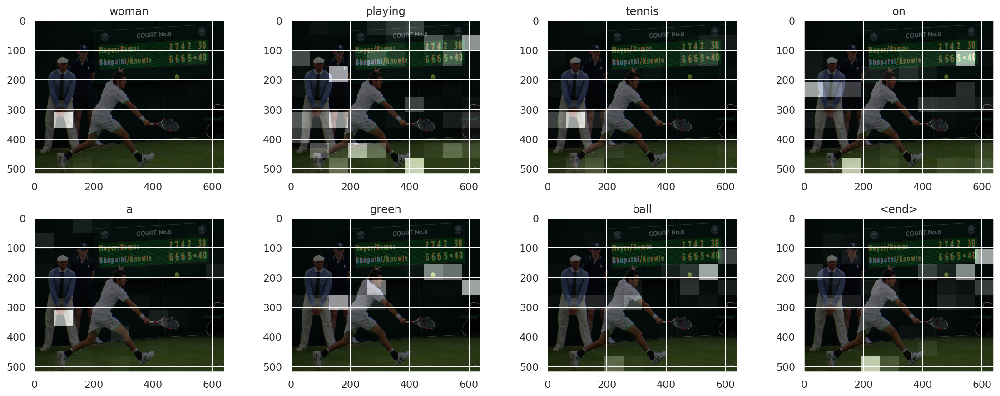


Real Caption: <start>a kitchen and living room combined with a shop <unk> <end>

Predicted Caption: <start> is a small bathroom with light hanging from windows <end>


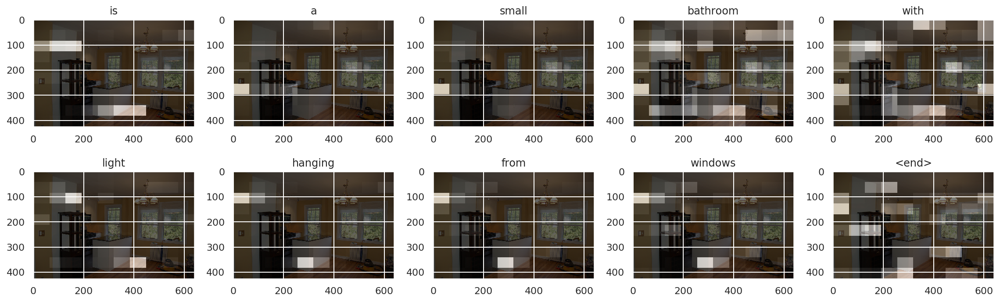


Real Caption: <unk> group poses for photo <unk> together on their bikes <end>

Predicted Caption: <start> of people on big in a row in a row of people in the police them <end>


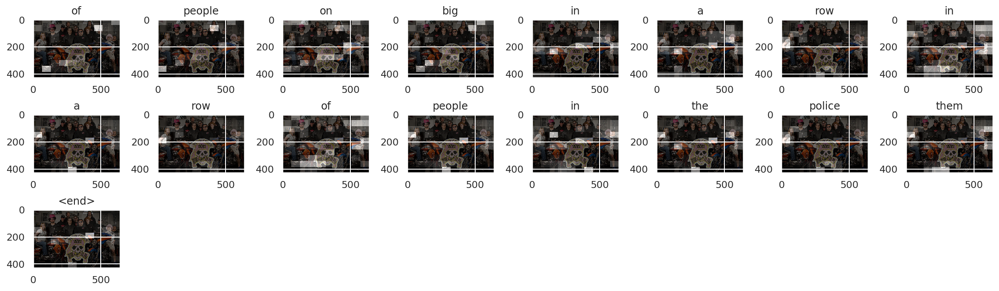


Real Caption: <start>five dogs and one cat near a street stop sign <end>

Predicted Caption: <start> crowd of people is walking down a city street <end>


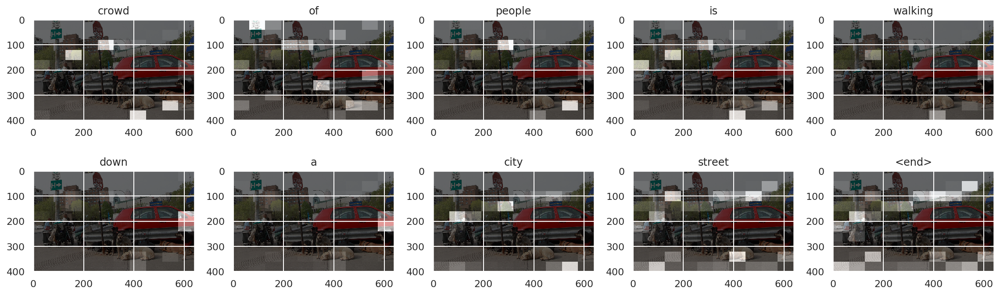

In [144]:
for i in range(20):
  rid = np.random.randint(0, len(img_name_val))
  image = img_name_val[rid]
  real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
  result, attention_plot = evaluate(image)
  print("Real Caption: %20s" % real_caption)
  print()
  print("Predicted Caption: <start> %20s"%(" ".join(result)))
  plot_attention(image, result, attention_plot)
  print()

In [146]:
from google.colab import files
files.upload()

Saving IMG_20200122_163940.jpg to IMG_20200122_163940.jpg


{'IMG_20200122_163940.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xe1\x01\x8fExif\x00\x00MM\x00*\x00\x00\x00\x08\x00\x06\x01\x10\x00\x02\x00\x00\x00\n\x00\x00\x00V\x011\x00\x02\x00\x00\x00\x10\x00\x00\x00`\x01\x12\x00\x03\x00\x00\x00\x01\x00\x06\x00\x00\x87i\x00\x04\x00\x00\x00\x01\x00\x00\x00{\x88%\x00\x04\x00\x00\x00\x01\x00\x00\x01a\x01\x0f\x00\x02\x00\x00\x00\x0b\x00\x00\x00p\x00\x00\x00\x00Nokia 2.2\x0000WW_1_630_SP03\x00HMD Global\x00\x00\x0b\x82\x9d\x00\x05\x00\x00\x00\x01\x00\x00\x01\x05\x92\n\x00\x05\x00\x00\x00\x01\x00\x00\x01\r\x82\x9a\x00\x05\x00\x00\x00\x01\x00\x00\x01\x15\x92\t\x00\x03\x00\x00\x00\x01\x00\x00\x00\x00\x88\'\x00\x03\x00\x00\x00\x01\x00j\x00\x00\x92\x07\x00\x03\x00\x00\x00\x01\x00\x02\x00\x00\x92\x86\x00\x07\x00\x00\x00(\x00\x00\x01\x1d\xa4\x03\x00\x03\x00\x00\x00\x01\x00\x00\x00\x00\x90\x03\x00\x02\x00\x00\x00\x14\x00\x00\x01E\x88"\x00\x03\x00\x00\x00\x01\x00\x00\x00\x00\x92\x02\x00\x05\x00\x00\x00\x01\x00\x00\x01Y\x00\x

16384/12889 [======================================] - 0s 0us/step
Prediction Caption: person riding the ocean wave <end>


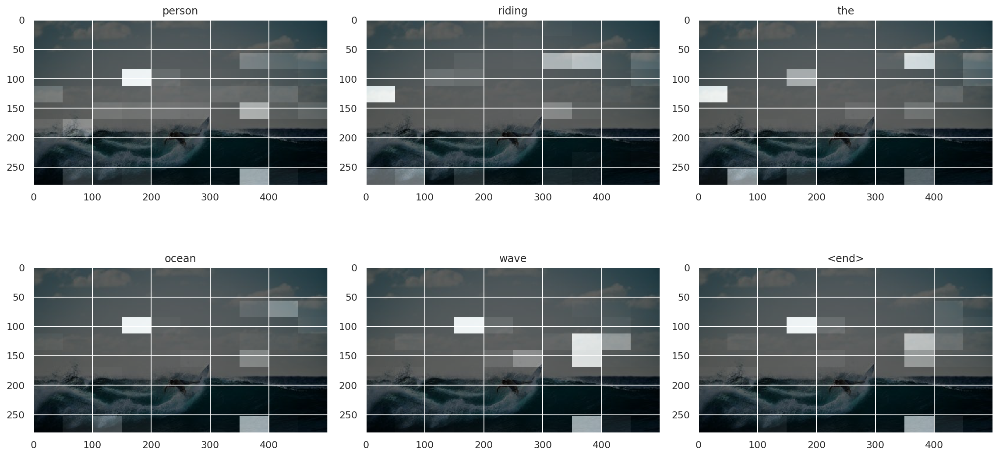

In [175]:
image_url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcS8nyuZIPMghhbCBjlwhXQP822Z1yqsqqsiY6E5XXITv4a6A3q9'
image_extension = image_url[-4:]
image_path = tf.keras.utils.get_file('image'+image_extension,
                                     origin=image_url)

result, attention_plot = evaluate(image_path)
print('Prediction Caption:', ' '.join(result))
plot_attention(image_path, result, attention_plot)

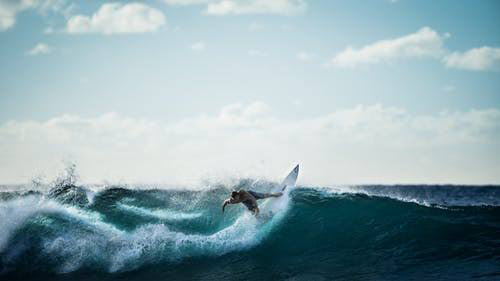

In [176]:
Image.open(image_path)